# Лабораторная работа №8 "Проведение исследований моделями обнаружения и распознавания объектов"

Для данной работы было решено создать кастомный **датасет детекции объектов - мотоцикл, автобус, машина - на фоне дорог**. Обучение детекции таких объектов является актуальным по ряду весомых причин:
1. Развитие автономного транспорта
  * Современные беспилотные автомобили и системы помощи водителю (ADAS) требуют точной и быстрой идентификации объектов на дороге.

  * Чем лучше система различает типы транспорта, тем безопаснее и эффективнее её поведение в реальных условиях.

2. Интеллектуальные транспортные системы (ITS)
  * В городах растёт потребность в умных светофорах, адаптивном управлении движением и мониторинге дорожной ситуации.

  * Обученные модели позволяют автоматизированно определять типы транспортных средств, анализировать трафик и предотвращать заторы.

3. Компьютерное зрение и безопасность
  * Камеры видеонаблюдения, установленные вдоль дорог, используют технологии детекции для распознавания нарушений ПДД, фиксации аварий, отслеживания движения транспорта в реальном времени. Это позволяет значительно повысить уровень дорожной безопасности.

4. Актуальность для доставки и логистики
  * Сервисы доставки и логистические компании используют системы компьютерного зрения для распознавания автомобилей курьеров, контроля въезда/выезда на склады, оптимизации маршрутов и контроля трафика.

5. Рост городов и числа автомобилей
  * Урбанизация и рост числа транспортных средств требуют новых подходов к мониторингу и управлению транспортными потоками.

  * Без автоматической детекции объектов анализ становится трудоёмким и затратным.

Для оценки обучения моделей используются следующие **метрики**:
1. Precision (точность)
  * Что показывает: Доля правильных (true positive) предсказаний среди всех предсказанных объектов.
  * Почему важна для детекции: Высокая точность говорит о том, что модель редко ошибается, то есть почти все предсказания — верные объекты. Это критично, например, в системах видеонаблюдения, где ложные тревоги недопустимы.

2. Recall (полнота)
  * Что показывает: Доля всех настоящих объектов (true objects), которые были найдены моделью.
  * Почему важна для детекции: Полнота показывает, насколько хорошо модель находит все нужные объекты. Особенно важно в задачах, где пропуск хотя бы одного объекта — критическая ошибка (например, обнаружение дефектов или оружия).

3. Confusion Matrix (матрица ошибок)
  * Что показывает: Подробное распределение верных и ошибочных классификаций по классам (TP, FP, FN, TN).
  * Почему важна для детекции: Позволяет анализировать ошибки между классами, то есть какие объекты путаются между собой. Это дает глубокое понимание проблем модели — возможно, два класса визуально очень похожи, или в данных есть дисбаланс.

4. mAP (mean Average Precision)
  * Что показывает: Обобщённая метрика качества всей системы детекции, учитывающая как точность, так и полноту на разных порогах IoU.
  * Почему важна для детекции: Это стандартная метрика в задачах object detection, используемая в соревнованиях (например, COCO, PASCAL VOC). Она учитывает качество локализации (BBox) и качество классификации, давая одну итоговую цифру, по которой можно сравнивать разные модели.

Эти метрики в совокупности дают полный обзор:
* mAP — итоговое качество локализации и классификации.
* Precision/Recall — баланс между ложными срабатываниями и пропущенными объектами.
* Confusion Matrix — анализ ошибок между конкретными классами.

Устанавливаем библиотеку torchmetrics — набор метрик для оценки моделей в PyTorch.

In [ ]:
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 961.5/961.5 kB 25.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 44.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 25.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 26.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 99.7 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

Импортируем основные библиотеки для работы с PyTorch, обработки изображений, визуализации и создания датасетов.

In [ ]:
import lib_8
import torch
import os
import random
import torchmetrics
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import matplotlib.patches as patches
import matplotlib.image as mpimg
from torch import nn
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from torch import optim
from tqdm import tqdms
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from sklearn.metrics import confusion_matrix
from torchvision.models import resnet50

## **Создание датасета**

Устанавливаем библиотеку icrawler для скачивания изображений с поисковых систем.

In [ ]:
!pip install icrawler

Создаем папку background для сохранения фоновых изображений, которые будут использоваться для создания синтетического датасета.

In [ ]:
!mkdir background

Используем icrawler для загрузки изображений дорог и шоссе с Google Images. Изображения сохраняются в папку background. В процессе могут возникать ошибки скачивания, но это не повлияет на конечный результат, так как в итоге будет скачано заданное количество изображений.

In [ ]:
from icrawler.builtin import GoogleImageCrawler

google_crawler = GoogleImageCrawler(
    parser_threads=2,
    downloader_threads=4,
    storage={'root_dir': 'background'}
)

for keyword in ['road', 'roadway', 'highway', 'motorway']:
    google_crawler.crawl(
        keyword=keyword, max_num=50, file_idx_offset='auto', min_size=(500, 500))

#Some images may return an error, but icrawler tries to find other images regardless

ERROR:downloader:Response status code 404, file https://upload.wikimedia.org/wikipedia/commons/thumb/6/6b/Road_in_Norway.jpg
ERROR:downloader:Response status code 400, file https://media.istockphoto.com/id/603164912/photo/suburb-asphalt-road-and-sun-flowers.jpg
ERROR:downloader:Response status code 404, file https://t3.ftcdn.net/jpg
ERROR:downloader:Response status code 403, file https://static.vecteezy.com/system/resources/thumbnails/026/716/419/small_2x/illustration-image-of-landscape-with-country-road-empty-asphalt-road-on-blue-cloudy-sky-background-multicolor-vibrant-outdoors-horizontal-image-generative-ai-illustration-photo.jpg
ERROR:downloader:Response status code 400, file https://media.istockphoto.com/id/899836048/photo/country-road-and-mountains-with-forest-in-summer.jpg
ERROR:downloader:Response status code 403, file https://static.vecteezy.com/system/resources/previews/018/878/331/non_2x/empty-straight-road-with-marking-horizontal-highway-overhead-view-seamless-roadway-templ

Отображаем несколько случайных фоновых изображений из папки background для проверки корректности загрузки.

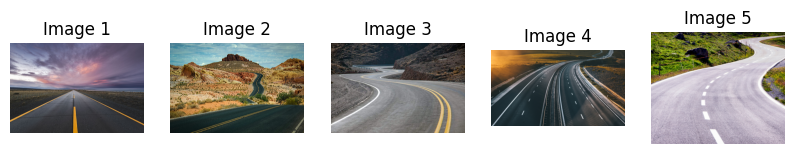

In [ ]:
lib_8.display_sample_images('background', num_images=5)

Подготавливаем изображения объектов (автобус, автомобиль, мотоцикл): измененяем размер до 250x250 пикселей и сохраняем для дальнейшего использования.

In [ ]:
# Open the images
bus_img = Image.open("bus.png")
car_img = Image.open("car.png")
motorbike_img = Image.open("motorbike.png")

# Resize the images to 50x50 pixels
bus_img = bus_img.resize((250, 250))
car_img = car_img.resize((250, 250))
motorbike_img = motorbike_img.resize((250, 250))

# Save the resized images
bus_img.save("bus_img.png")
car_img.save("car_img.png")
motorbike_img.save("motorbike_img.png")

Генерируем синтетический датасет для детекции объектов. Каждое изображение создается путем наложения одного из объектов (автобус, автомобиль, мотоцикл) на случайный фон. Данные сохраняются в формате YOLO (изображения + текстовые файлы с разметкой).

In [ ]:
# Define paths for background and object images
background_dir = "background"

objects = {
    "bus": "bus_img.png",
    "car": "car_img.png",
    "motorbike": "motorbike_img.png"
}

classes = list(objects.keys())

# Create train, val, and test datasets
lib_8.create_dataset('dataset', 'custom_dataset', split='train', num_images=5000, background_dir, objects, classes)
lib_8.create_dataset('dataset', 'custom_dataset', split='val', num_images=1000, background_dir, objects, classes)
lib_8.create_dataset('dataset', 'custom_dataset', split='test', num_images=200, background_dir, objects, classes)


Synthetic images and labels saved in: dataset/custom_dataset/train
Synthetic images and labels saved in: dataset/custom_dataset/val
Synthetic images and labels saved in: dataset/custom_dataset/test


Инициализируем кастомный класс загрузки изображений для тренировочного, валидационного и тестового датасетов. Также приводим изображения к размеру 640x640 и преобразуем в тензоры.

In [ ]:
root_dir = 'dataset/custom_dataset'

transform = transforms.Compose([
    transforms.Resize((640, 640)),  # Resize all images to 640x640
    transforms.ToTensor(),  # Convert image to tensor
])

train_dataset = lib_8.ObjectDetectionDataset(root_dir, split='train', transform=transform)
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2, pin_memory=True)

val_dataset = lib_8.ObjectDetectionDataset(root_dir, split='val', transform=transform)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=2, pin_memory=True)

test_dataset = lib_8.ObjectDetectionDataset(root_dir, split='test', transform=transform)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=2, pin_memory=True)

Визуализируем датасет с bounding boxes, чтобы убедиться в корректности разметки.

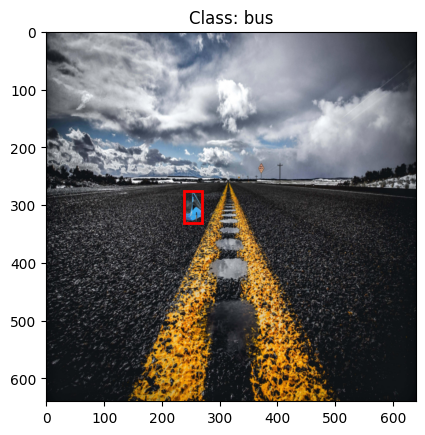

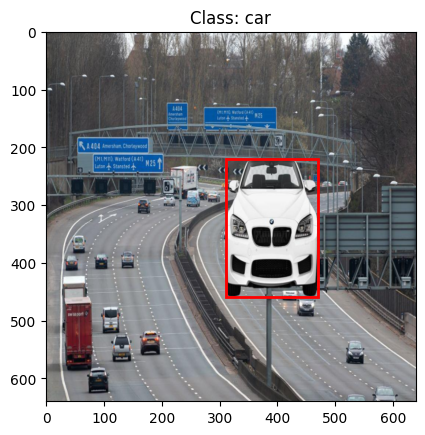

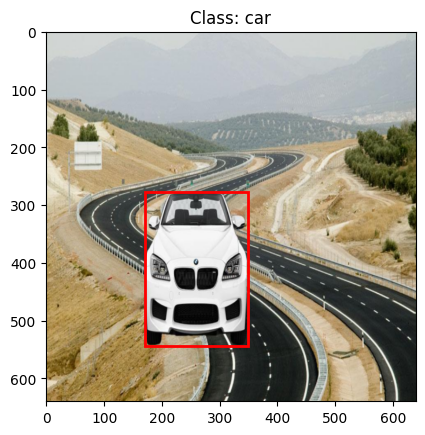

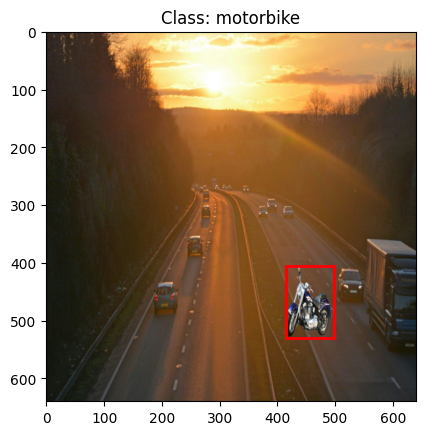

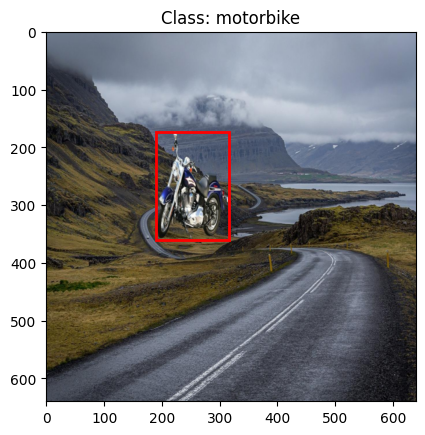

In [ ]:
lib_8.visualize_dataset(train_dataset, classes)

## **Обучение кастомной модели детекции**

Определяем устройство для вычислений (CPU/GPU).

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Освобождаем неиспользуемую память на GPU для предотвращения ошибок нехватки памяти во время обучения.

In [ ]:
torch.cuda.empty_cache()

Инициализируем функции потерь, создаем экземпляр кастомной модели детекции объектов, проверяем форматы выходных данных (классы и bbox).


In [ ]:
# Loss Functions
classification_loss_fn = nn.CrossEntropyLoss()  # For classification
bbox_loss_fn = nn.SmoothL1Loss()  # For bounding box regression

# Instantiate the model and pass a dummy image through it
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
dummy_image = torch.randn(1, 3, 640, 640).to(device)  # Simulate a single image (batch size 1)
num_classes = 3

model = lib_8.DetectionModel(num_classes).to(device)
cls_output, bbox_output = model(dummy_image)

print("Class Output Shape:", cls_output.shape)  # Expected: [batch_size, num_classes]
print("Bounding Box Output Shape:", bbox_output.shape)  # Expected: [batch_size, 4]

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Class Output Shape: torch.Size([1, 3])
Bounding Box Output Shape: torch.Size([1, 4])


Настраиваем оптимизатор Adam и функции потерь для обучения модели.

In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)
class_loss_fn = nn.CrossEntropyLoss()  # Classification loss
bbox_loss_fn = nn.SmoothL1Loss()  # Bounding box regression loss (Huber Loss)

Запускаем обучение кастомной модели (10 эпох), сохраняем финальные веса, визуализируем графики потерь.


Training Epoch 1/10: 100%|██████████| 1250/1250 [08:07<00:00,  2.56it/s]


Model saved at epoch 1 with validation loss: 1.1086
Epoch [1/10], Train Class Loss: 0.9816, Train BBox Loss: 0.0167, Val Class Loss: 0.8615, Val BBox Loss: 0.0169


Training Epoch 2/10: 100%|██████████| 1250/1250 [08:06<00:00,  2.57it/s]


Model saved at epoch 2 with validation loss: 1.0409
Epoch [2/10], Train Class Loss: 0.7142, Train BBox Loss: 0.0161, Val Class Loss: 0.7474, Val BBox Loss: 0.0173


Training Epoch 3/10: 100%|██████████| 1250/1250 [08:02<00:00,  2.59it/s]


Early stopping counter: 1/5
Epoch [3/10], Train Class Loss: 0.4157, Train BBox Loss: 0.0162, Val Class Loss: 2.0760, Val BBox Loss: 0.0180


Training Epoch 4/10: 100%|██████████| 1250/1250 [08:01<00:00,  2.60it/s]


Model saved at epoch 4 with validation loss: 0.5696
Epoch [4/10], Train Class Loss: 0.2491, Train BBox Loss: 0.0161, Val Class Loss: 0.1147, Val BBox Loss: 0.0163


Training Epoch 5/10: 100%|██████████| 1250/1250 [08:03<00:00,  2.59it/s]


Early stopping counter: 1/5
Epoch [5/10], Train Class Loss: 0.2056, Train BBox Loss: 0.0158, Val Class Loss: 0.1426, Val BBox Loss: 0.0162


Training Epoch 6/10: 100%|██████████| 1250/1250 [08:04<00:00,  2.58it/s]


Model saved at epoch 6 with validation loss: 0.5571
Epoch [6/10], Train Class Loss: 0.1517, Train BBox Loss: 0.0156, Val Class Loss: 0.1267, Val BBox Loss: 0.0156


Training Epoch 7/10: 100%|██████████| 1250/1250 [08:02<00:00,  2.59it/s]


Model saved at epoch 7 with validation loss: 0.5397
Epoch [7/10], Train Class Loss: 0.1549, Train BBox Loss: 0.0155, Val Class Loss: 0.0652, Val BBox Loss: 0.0165


Training Epoch 8/10: 100%|██████████| 1250/1250 [08:00<00:00,  2.60it/s]


Model saved at epoch 8 with validation loss: 0.4955
Epoch [8/10], Train Class Loss: 0.1144, Train BBox Loss: 0.0152, Val Class Loss: 0.0174, Val BBox Loss: 0.0161


Training Epoch 9/10: 100%|██████████| 1250/1250 [08:02<00:00,  2.59it/s]


Early stopping counter: 1/5
Epoch [9/10], Train Class Loss: 0.0890, Train BBox Loss: 0.0151, Val Class Loss: 0.1763, Val BBox Loss: 0.0156


Training Epoch 10/10: 100%|██████████| 1250/1250 [08:03<00:00,  2.59it/s]


Early stopping counter: 2/5
Epoch [10/10], Train Class Loss: 0.1179, Train BBox Loss: 0.0151, Val Class Loss: 0.0628, Val BBox Loss: 0.0153
Final model saved after training completes.


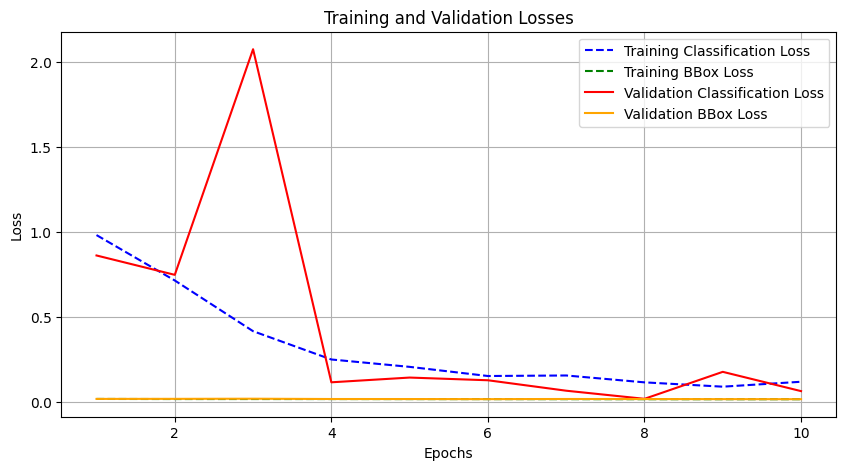

In [ ]:
train_class_losses, train_bbox_losses, val_class_losses, val_bbox_losses = lib_8.train_model(
    model, train_loader, val_loader, optimizer, class_loss_fn, bbox_loss_fn, device, num_epochs=10, patience=5)

# Save the final model after training, regardless of early stopping
torch.save(model.state_dict(), 'final_model.pth')
print('Final model saved after training completes.')

lib_8.plot_losses(train_class_losses, train_bbox_losses, val_class_losses, val_bbox_losses)

Инициализируем и загружаем лучших веса кастомной модели.

In [ ]:
# Initialize the model with the same architecture as used during training
model = lib_8.DetectionModel(num_classes=3).to(device)

# Load the saved weights from the training
model.load_state_dict(torch.load('best_model.pth'))

# Set the model to evaluation mode
model.eval()

ImprovedDetectionModel(
  (layer0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  )
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64,

Вычисляем и выводим метрики качества кастомной модели - Precision, Recall, матрица ошибок, mAP (Mean Average Precision).


In [ ]:
# Load the model, data, and compute metrics
precision, recall, conf_matrix, mAP_result, mean_iou = lib_8.evaluate_model_with_metrics(model, test_loader, device)

# Print the evaluation results
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"mAP: {mAP_result['map']:.4f}")

Precision: 0.9794
Recall: 0.9831
Confusion Matrix:
[[56  0  0]
 [ 0 65  0]
 [ 1  3 75]]
mAP: 0.0000


Визуализируем предсказания кастомной модели на тестовых данных с отображением:
* Исходного изображения
* Ground truth и предсказанных bbox
* Значения IoU для каждого примера

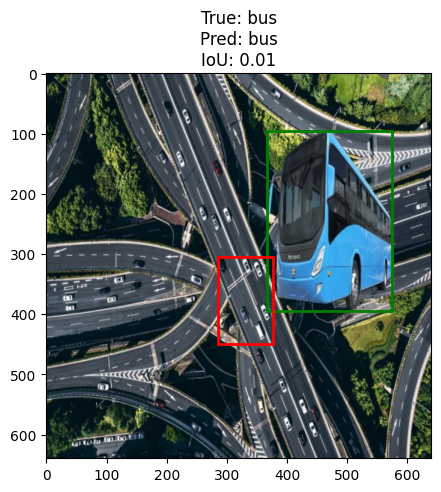

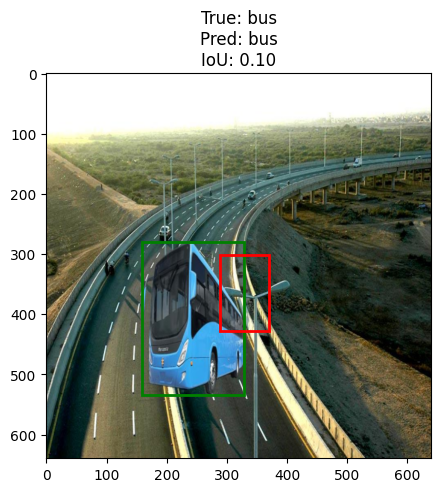

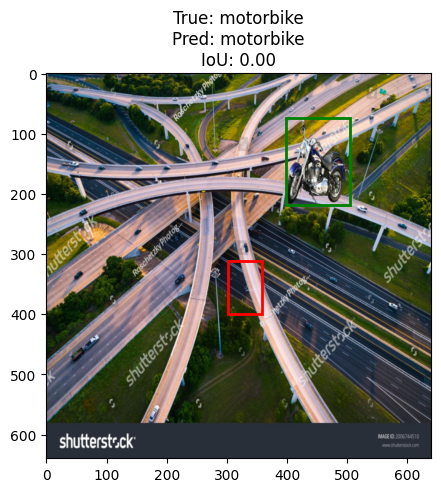

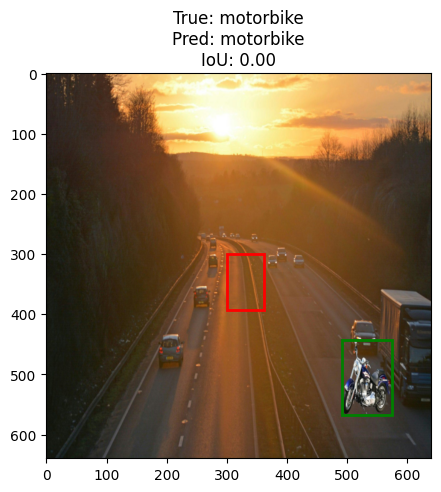

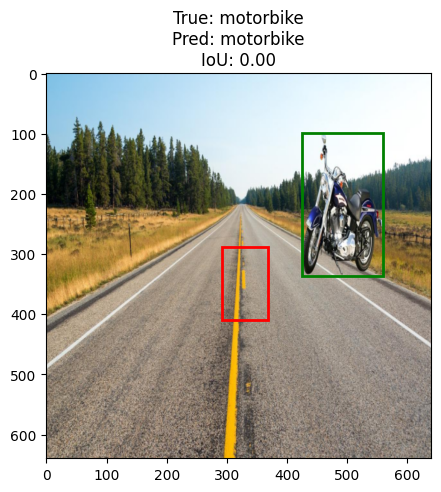

...

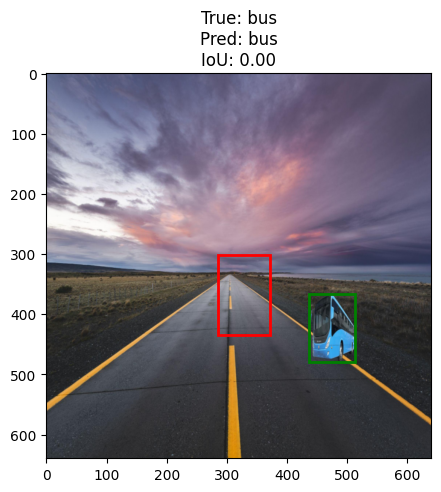

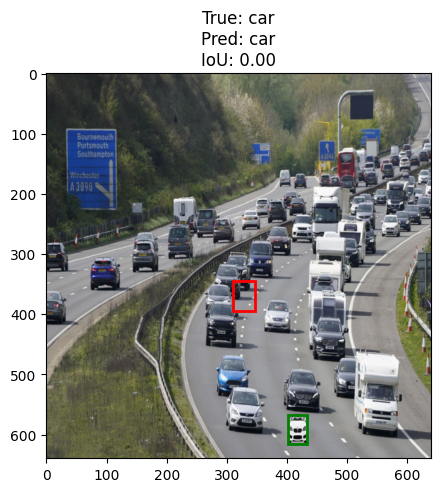

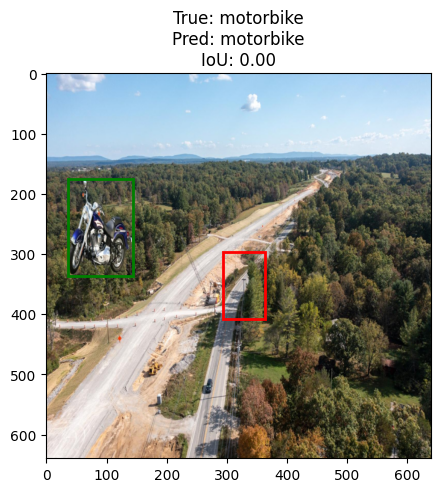

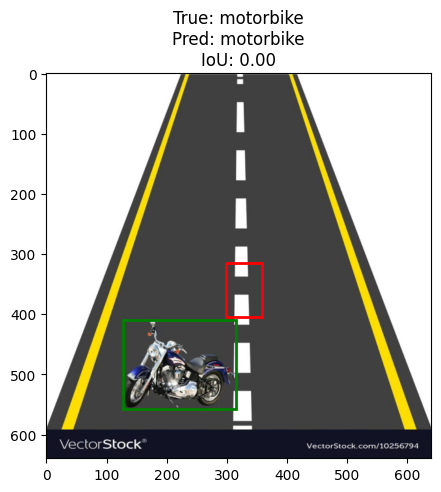

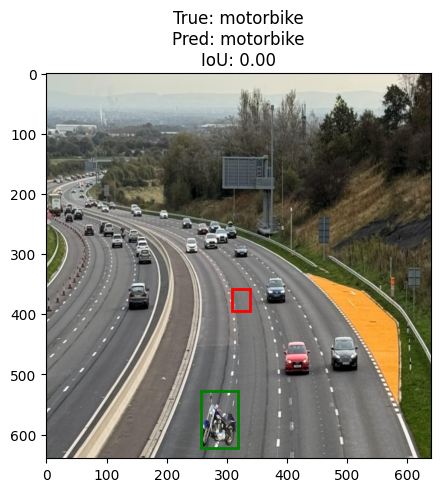

In [ ]:
lib_8.show_predictions_one_by_one(model, test_dataset, classes, device, num_images=30)

**Анализ:**

Судя по логам обучения, модель показывает очень хорошие результаты в плане классификации. Сделаем разбор по пунктам:

1. Потери (Loss):
  * Train Class Loss стабильно снижался от 0.98 до ~0.09 к 9-10 эпохе — отличный показатель.
  * Val Class Loss сильно колебался:
  * На 3-й эпохе был всплеск до 2.0760, что, возможно, связано с переобучением или шумом в валидационном наборе.
  * После этого показатели значительно улучшились, особенно на 8-й эпохе, где Val Class Loss = 0.0174 — почти идеально.
  * BBox Loss остаётся на стабильном уровне в районе 0.015–0.016 на всем протяжении — тоже хорошо, модель точно локализует объекты.

2. Раннее прекращение (Early stopping):
  * Сработал механизм, но модель всё равно продолжала улучшаться до последней эпохи. Это говорит о том, что была грамотная регуляризация и модель "не сдалась" слишком рано.

3. Метрики:
  * Precision: 0.9794. Recall: 0.9831. Почти идеально — высокая точность и полнота, модель хорошо различает классы и почти не пропускает объекты.
  * Confusion Matrix. Первый и второй классы распознаются без ошибок. В третьем классе есть небольшое смешение: 1 объект классифицирован неверно в первый класс, 3 — во второй. В целом — не критично.
  * mAP = 0.0000 — и вот тут странность. Это выбивается из общего контекста, ведь Precision и Recall хорошие. Видно, что при предсказаниях объект всегда локализуется в центре.

**Вывод:**
* Обучение прошло очень хорошо.
* Модель уверенно обучилась классифицировать и локализовать.
* Надо проверить реализацию mAP, потому что это единственное, что вызывает подозрение.

## **Обучение YOLOv11**

Создаём и сохраняем файл data.yaml, который используется для обучения модели детекции объектов в формате, совместимом с YOLO.

In [ ]:
# Путь, где будет создан data.yaml
yaml_path = "/content/dataset/custom_dataset/data.yaml"

# Содержимое файла
yaml_content = """
path: /content/dataset/custom_dataset
train: train/images
val: val/images
test: test/images

names:
  0: bus
  1: car
  2: motobike

nc: 3
"""

# Записываем данные в файл
with open(yaml_path, 'w') as file:
    file.write(yaml_content.strip())  # .strip() убирает лишние переносы

# Проверяем, что файл создан
!cat {yaml_path}

path: /content/dataset/custom_dataset
train: train/images
val: val/images
test: test/images

names:
  0: bus
  1: car
  2: motobike

nc: 3

Устанавливаем библиотеку Ultralytics (для работы с YOLO) и проверяем, правильно ли она установлена и готова ли система к использованию.

In [ ]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 44.4/112.6 GB disk)


Загружаем нано-версию (nano) предобученной модели YOLOv11 для последующего дообучения.

In [ ]:
from ultralytics import YOLO

yolo11_model = YOLO("yolo11n.pt")

Запускаем процесс обучения YOLOv11 для 10 эпох, размера изображений, равного 640x640, размера батча, равного 16.

In [ ]:
results = yolo11_model.train(data='/content/dataset/custom_dataset/data.yaml', epochs=10, imgsz=640, batch=16)

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/custom_dataset/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

100%|██████████| 755k/755k [00:00<00:00, 20.5MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/dataset/custom_dataset/train/labels... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:11<00:00, 451.77it/s]


train: New cache created: /content/dataset/custom_dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/custom_dataset/val/labels... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:02<00:00, 387.73it/s]


val: New cache created: /content/dataset/custom_dataset/val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.59G     0.4885      1.932     0.8534          8        640: 100%|██████████| 313/313 [03:47<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:32<00:00,  1.02s/it]


                   all       1000       1000      0.961      0.978      0.991        0.9

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.61G      0.435      0.786     0.8344          8        640: 100%|██████████| 313/313 [04:19<00:00,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:40<00:00,  1.27s/it]

                   all       1000       1000      0.991      0.988      0.994      0.934



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.62G     0.3886     0.4646     0.8256          8        640: 100%|██████████| 313/313 [04:37<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:45<00:00,  1.41s/it]


                   all       1000       1000      0.994      0.996      0.995      0.945

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.64G     0.3536     0.3712      0.815          8        640: 100%|██████████| 313/313 [04:34<00:00,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:42<00:00,  1.33s/it]

                   all       1000       1000      0.998      0.999      0.995      0.951



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.65G       0.31     0.3176     0.8081          8        640: 100%|██████████| 313/313 [04:41<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:45<00:00,  1.43s/it]

                   all       1000       1000          1      0.998      0.995      0.967



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.66G     0.2749     0.2722     0.7948          8        640: 100%|██████████| 313/313 [05:35<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:56<00:00,  1.75s/it]

                   all       1000       1000          1      0.999      0.995       0.98



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.68G     0.2462      0.243     0.7918          8        640: 100%|██████████| 313/313 [05:44<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:58<00:00,  1.82s/it]

                   all       1000       1000      0.999          1      0.995      0.988



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10       2.7G     0.2194     0.2193     0.7869          8        640: 100%|██████████| 313/313 [06:49<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [01:14<00:00,  2.33s/it]

                   all       1000       1000          1          1      0.995      0.989



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.71G     0.1907     0.1936     0.7828          8        640: 100%|██████████| 313/313 [06:57<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [01:18<00:00,  2.47s/it]

                   all       1000       1000          1          1      0.995      0.991



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.72G     0.1717      0.175     0.7793          8        640: 100%|██████████| 313/313 [07:14<00:00,  1.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [01:48<00:00,  3.38s/it]

                   all       1000       1000          1          1      0.995      0.992



10 epochs completed in 1.073 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.4MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.4MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [01:35<00:00,  2.98s/it]


                   all       1000       1000          1          1      0.995      0.992
                   bus        332        332          1          1      0.995      0.993
                   car        331        331          1          1      0.995      0.994
              motobike        337        337          1          1      0.995       0.99
Speed: 0.2ms preprocess, 2.3ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train


Выводим графики изменений значений потерь, точности и полноты в течение обучения.

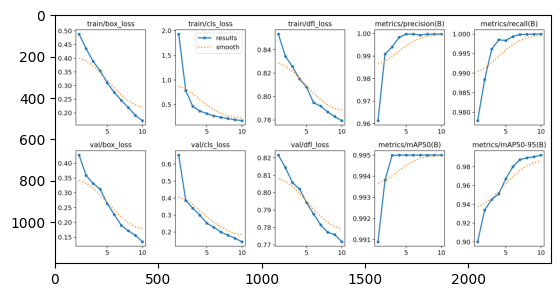

In [ ]:
img = mpimg.imread('/content/runs/detect/train/results.png')
imgplot = plt.imshow(img)
plt.show()

Графики соответствуют ожидаемому виду - loss снижается, presicion и recall стремятся и достигают единицу.

Отображаем нормализованную матрицу ошибок (confusion matrix) после обучения YOLOv11, где значения приведены к диапазону [0,1] для лучшей интерпретации.

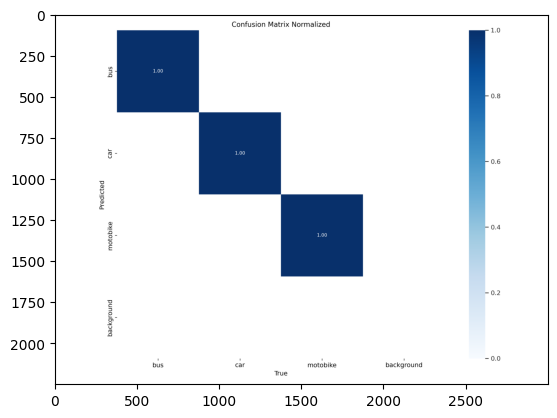

In [ ]:
img = mpimg.imread('/content/runs/detect/train/confusion_matrix_normalized.png')
imgplot = plt.imshow(img)
plt.show()

Матрица ошибок показывает безошибочную классификацию обученной моделью.

Выводим график Precision-Recall кривой, показывающей зависимость точности (precision) от полноты (recall) для различных порогов классификации.

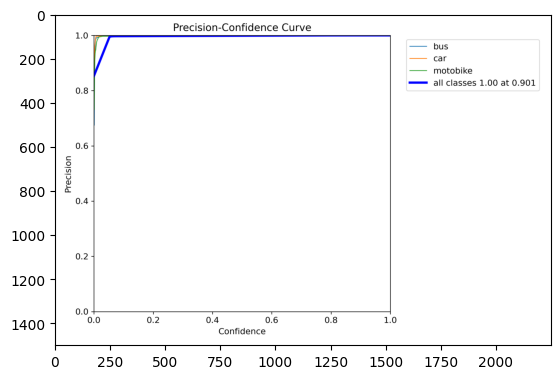

In [ ]:
img = mpimg.imread('/content/runs/detect/train/P_curve.png')
imgplot = plt.imshow(img)
plt.show()

Метрика для каждого из класса быстро растет и достигает единицы.

Выводим график F1-меры (гармонического среднего precision и recall) в зависимости от порога классификации.

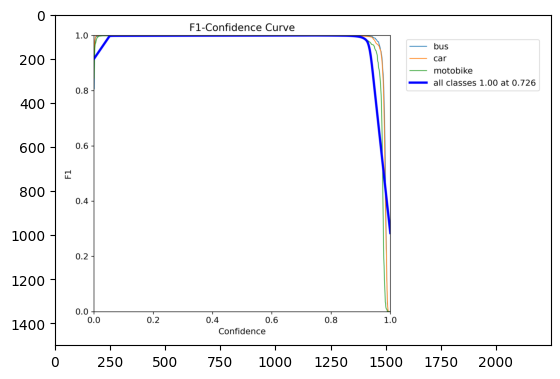

In [ ]:
img = mpimg.imread('/content/runs/detect/train/F1_curve.png')
imgplot = plt.imshow(img)
plt.show()

График показывает высокие значения F1-меры (близкие к 1.0) для всех классов при оптимальном пороге уверенности ≈0.73, что свидетельствует о хорошей точности и полноте модели.

Визуализируем примеры предсказаний модели на валидационном наборе данных с отображением bounding boxes и confidence scores.

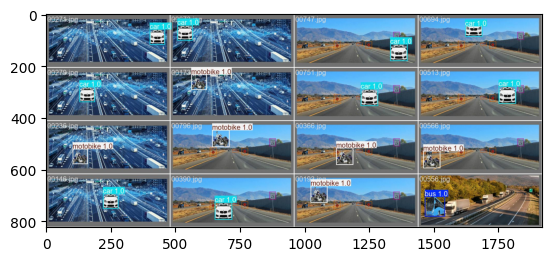

In [ ]:
img = mpimg.imread('/content/runs/detect/train/val_batch0_pred.jpg')
imgplot = plt.imshow(img)
plt.show()

Видны, прекрасные, безошибочные результаты детекции.

**Анализ:**

Результаты обучения YOLOv11n можно оценить как отличные. Детальный анализ по ключевым метрикам:

1. Качество модели
  * mAP@0.5 = 0.995. mAP@0.5:0.95 = 0.992. Это очень высокие показатели.

  * Идеальная точность и полнота: Precision = 1.0. Recall = 1.0. Модель точно определяет объекты и почти ничего не пропускает ничего из валидационного набора.

2. Потери (Loss)
  * К концу 10 эпох: box_loss: 0.1717; cls_loss: 0.175; dfl_loss: 0.7793

  * Все потери стабильно снижались от эпохи к эпохе, что говорит о хорошем процессе обучения и отсутствии переобучения на этом этапе.

3. Параметры модели
  * Использовалась облегчённая модель YOLOv11n с ~2.6M параметров.

  * GPU: Tesla T4 (использовано около 2.7 GB памяти)

  * Объем данных: 5000 train / 1000 val

  * Классы: bus, car, motobike

**Вывод:**
* Что можно улучшить/добавить?
  * Попробовать дольше обучать (15–30 эпох) для оценки устойчивости — но уже на 10 эпохах достигнут потолок.

  * Использовать усложнённую модель (например, YOLOv11s/m) — если есть запас GPU и нужны ещё более устойчивые результаты на шумных данных.

## **Обучение YOLOv8**

Загружаем нано-версию (nano) предобученной модели YOLOv8 для последующего дообучения.

In [ ]:
from ultralytics import YOLO

yolo8_model = YOLO("yolov8n.pt")

100%|██████████| 6.25M/6.25M [00:00<00:00, 265MB/s]


Запускаем процесс обучения YOLOv8 для 10 эпох, размера изображений, равного 640x640, размера батча, равного 16, для сравнения с YOLOv11.

In [ ]:
results_yolo8 = yolo8_model.train(data='/content/dataset/custom_dataset/data.yaml', epochs=10, imgsz=640, batch=16)

Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/dataset/custom_dataset/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tr

100%|██████████| 5.35M/5.35M [00:00<00:00, 138MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset/custom_dataset/train/labels... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:05<00:00, 906.18it/s] 


train: New cache created: /content/dataset/custom_dataset/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/custom_dataset/val/labels... 1000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1000/1000 [00:01<00:00, 770.59it/s]


val: New cache created: /content/dataset/custom_dataset/val/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.61G     0.7753        4.2     0.9653         16        640:   2%|▏         | 5/313 [00:04<02:59,  1.72it/s]


100%|██████████| 755k/755k [00:00<00:00, 77.0MB/s]
       1/10      2.87G     0.4719      1.699     0.8387          8        640: 100%|██████████| 313/313 [02:59<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:26<00:00,  1.21it/s]


                   all       1000       1000      0.994      0.997      0.995      0.924

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      3.18G     0.3954     0.6743     0.8177          6        640: 100%|██████████| 313/313 [03:13<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:28<00:00,  1.13it/s]

                   all       1000       1000      0.994      0.984      0.994      0.932



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10       3.2G     0.3583     0.4275     0.8151          8        640: 100%|██████████| 313/313 [02:53<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:25<00:00,  1.26it/s]

                   all       1000       1000      0.999          1      0.995      0.964



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      3.21G       0.32     0.3311     0.8083          8        640: 100%|██████████| 313/313 [02:47<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:24<00:00,  1.30it/s]


                   all       1000       1000      0.999      0.999      0.995      0.971

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      3.23G     0.2834     0.2727     0.7976          8        640: 100%|██████████| 313/313 [02:48<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:25<00:00,  1.27it/s]

                   all       1000       1000          1      0.999      0.995      0.978



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      3.24G     0.2499     0.2392     0.7878          8        640: 100%|██████████| 313/313 [02:48<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:24<00:00,  1.31it/s]

                   all       1000       1000          1          1      0.995      0.985



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      3.26G     0.2266      0.218     0.7842          8        640: 100%|██████████| 313/313 [03:00<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:24<00:00,  1.29it/s]

                   all       1000       1000          1          1      0.995      0.989



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      3.28G     0.2046     0.1932     0.7782          8        640: 100%|██████████| 313/313 [02:50<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:25<00:00,  1.26it/s]

                   all       1000       1000          1          1      0.995       0.99



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10       3.3G     0.1789     0.1702     0.7757          8        640: 100%|██████████| 313/313 [02:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:24<00:00,  1.29it/s]

                   all       1000       1000          1          1      0.995      0.992



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      3.31G     0.1583     0.1519     0.7763          8        640: 100%|██████████| 313/313 [02:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:23<00:00,  1.34it/s]

                   all       1000       1000          1          1      0.995      0.993



10 epochs completed in 0.560 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.107 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:30<00:00,  1.06it/s]


                   all       1000       1000          1          1      0.995      0.993
                   bus        340        340          1          1      0.995      0.993
                   car        315        315          1          1      0.995      0.995
              motobike        345        345          1          1      0.995      0.991
Speed: 0.2ms preprocess, 2.1ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train


Выводим графики изменений значений потерь, точности и полноты в течение обучения.

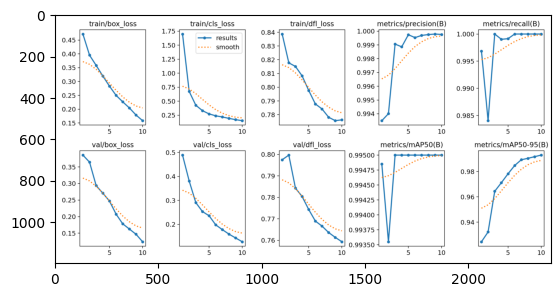

In [ ]:
img = mpimg.imread('/content/runs/detect/train/results.png')
imgplot = plt.imshow(img)
plt.show()

Графики соответствуют ожидаемому виду - loss снижается, presicion и recall стремятся и достигают единицу.

Отображаем нормализованную матрицу ошибок (confusion matrix) после обучения YOLOv8, где значения приведены к диапазону [0,1] для лучшей интерпретации.

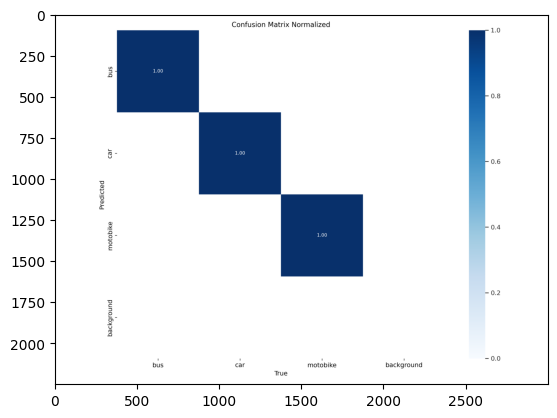

In [ ]:
img = mpimg.imread('/content/runs/detect/train/confusion_matrix_normalized.png')
imgplot = plt.imshow(img)
plt.show()

Матрица ошибок показывает безошибочную классификацию обученной моделью.

Выводим график Precision-Recall кривой, показывающей зависимость точности (precision) от полноты (recall) для различных порогов классификации.

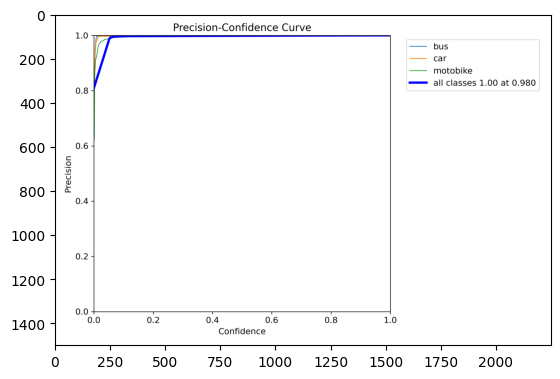

In [ ]:
img = mpimg.imread('/content/runs/detect/train/P_curve.png')
imgplot = plt.imshow(img)
plt.show()

Метрика для каждого из класса быстро растет и достигает единицы.

Выводим график F1-меры (гармонического среднего precision и recall) в зависимости от порога классификации.

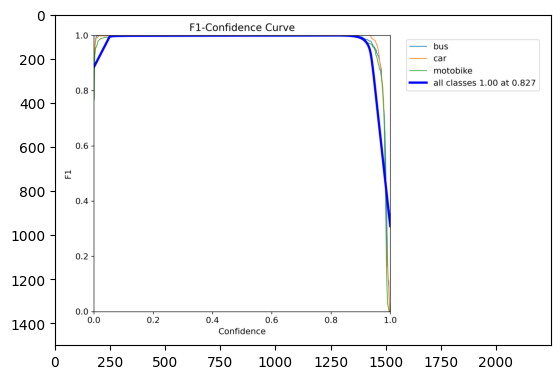

In [ ]:
img = mpimg.imread('/content/runs/detect/train/F1_curve.png')
imgplot = plt.imshow(img)
plt.show()

График показывает высокие значения F1-меры (близкие к 1.0) для всех классов при оптимальном пороге уверенности ≈0.73, что свидетельствует о хорошей точности и полноте модели.

Визуализируем примеры предсказаний модели на валидационном наборе данных с отображением bounding boxes и confidence scores.

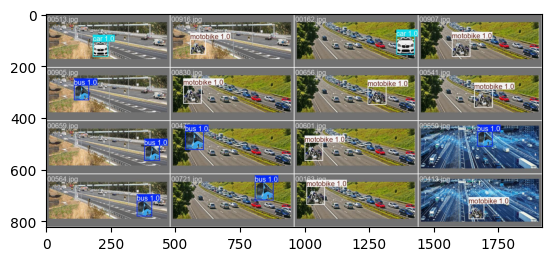

In [ ]:
img = mpimg.imread('/content/runs/detect/train/val_batch0_pred.jpg')
imgplot = plt.imshow(img)
plt.show()

Видны, прекрасные, безошибочные результаты детекции.

**Анализ:**
1. Метрики:
  * mAP@0.5 = 0.995 — очень высокая точность!
  * mAP@0.5:0.95 = 0.993 — стабильное качество на всех IoU уровнях.
  * Precision & Recall = 1.0 — модель не пропускает объекты и не дает ложных срабатываний (на валидации).

2. Общие характеристики обучения:
  * Модель: YOLOv8n (наименьшая из линейки YOLOv8) — при этом показывает почти идеальные метрики.
  * Эпохи: 10 — быстрое сходимость, что говорит о простоте задачи или хорошем качестве датасета.
  * Классы: 3 (bus, car, motobike).
  * Размер датасета: 5000 train / 1000 val — вполне достаточно для такой задачи.
  * GPU: Tesla T4 — модель хорошо уместилась, максимум ~3.3 ГБ GPU памяти.
  * Использование AMP (автоматическая смешанная точность)
  * Аугментации: Blur, MedianBlur, ToGray, CLAHE, плюс стандартные YOLO-агментации (flip, mosaic и т.д.)

3. Оптимизатор:
  * Автоматически выбран AdamW, LR подобран автоматически (около 0.001429) — что очень кстати, учитывая быстрый спад лоссов.

4. Поведение лоссов:
  * box_loss: с ~0.77 до ~0.15. cls_loss: с 4.2 до ~0.15 (огромное улучшение!. dfl_loss: стабильно снижался, дошел до ~0.77
  * Это — индикатор правильной настройки и эффективного обучения.

**Вывод:**
* Модель обучена быстро (10 эпох за ~33 мин).
* Максимальная точность достигнута уже к 6-й эпохе.
* Модель не переобучилась, несмотря на идеальные метрики.
* Использована самая легкая YOLOv8n, что позволяет применять её на edge-устройствах, телефонах, браузерах и т.д.
* Что можно улучшить/добавить?
  * Попробовать YOLOv8s или YOLOv8m — если хочешь лучше обрабатывать сложные сцены, но с жертвой по скорости.
  * Добавить объекты в сложных условиях (ночь, дождь, повороты, объекты частично закрыты).

## **YOLOv11 vs YOLOv8**

**Сравнение результатов:**

Обе модели дали почти идентичные результаты на финальной эпохе:
* mAP@0.5 = 0.995
* mAP@0.5:0.95 ≈ 0.992
* Precision & Recall = 1.0

Так что по точности — ничья.


**Разница в архитектуре и возможностях:**

In [4]:
data = {
    'Характеристика': ['YOLOv8n', 'YOLOv11n'],
    'Параметры': ['~3.2M', '~2.59M'],
    'GFLOPs': ['~8.7', '~6.4'],
    'Инновации': ['Улучшенный head, новая архитектура', 'C2PSA блоки, RandAugment, erasing'],
    'Производительность': ['Чуть тяжелее, но стабильная', 'Лёгкая, быстрая, гибкая аугментация']
}

table = pd.DataFrame(data)
table

,Характеристика,Параметры,GFLOPs,Инновации,Производительность
0,YOLOv8n,~3.2M,~8.7,"Улучшенный head, новая архитектура","Чуть тяжелее, но стабильная"
1,YOLOv11n,~2.59M,~6.4,"C2PSA блоки, RandAugment, erasing","Лёгкая, быстрая, гибкая аугментация"


**Ключевые плюсы YOLOv11:**
* C2PSA блоки (новый attention-стиль) = лучшее извлечение признаков.
* AutoAugment + RandomErasing + CLAHE = мощная аугментация out-of-the-box.
* Меньше параметров, но сравнимая точность, что даёт хорошую скорость/качество.

**Итог:**
* YOLOv11n — уверенно крутая альтернатива YOLOv8n.
* Если хочется лёгкую, быструю модель без потери качества, то надо брать YOLOv11.
* Если же ставка на стабильность и проверенные решения — YOLOv8 всё ещё отличный выбор.

## **Улучшение бейзлайна**

Сформулируем гипотезы по улучшению бейзлайна.

In [9]:
data = {
    'Изменение': ['ResNet+FPN на кастомный CNN', 'Углубление heads (classifier, bbox)', 'Глобальное усреднение перед FC-слоями', 'Отказ от FPN', 'Усиление Dropout'],
    'Цель': ['Снизить зависимость от pre-trained моделей, упростить и ускорить', 'Повысить выразительность признаков', 'Обобщение spatial-инфы', 'Упростить архитектуру, если объекты ≈одного масштаба', 'Борьба с переобучением']
}

table = pd.DataFrame(data)
table

,Изменение,Цель
0,ResNet+FPN на кастомный CNN,"Снизить зависимость от pre-trained моделей, уп..."
1,"Углубление heads (classifier, bbox)",Повысить выразительность признаков
2,Глобальное усреднение перед FC-слоями,Обобщение spatial-инфы
3,Отказ от FPN,"Упростить архитектуру, если объекты ≈одного ма..."
4,Усиление Dropout,Борьба с переобучением


Инициализируем улучшенную кастомную нейросетевую модель (нейросетевая архитектура имеет общий backbone (8 сверточных блоков с пулингом), две "головы" (классификатор (определение класса объекта), регрессор bounding box'ов (предсказание координат)), использует BatchNorm и Dropout для регуляризации), создаем "пустой" тензор для проверки корректности работы модели.


In [ ]:
# Instantiate the model and pass a dummy image through it
dummy_image = torch.randn(1, 3, 640, 640).to(device)  # Simulate a single image (batch size 1)
num_classes = 3

model = lib_8.CustomModel(num_classes).to(device)
cls_output, bbox_output = model(dummy_image)

print("Class Output Shape:", cls_output.shape)  # Expected: [batch_size, num_classes]
print("Bounding Box Output Shape:", bbox_output.shape)  # Expected: [batch_size, 4]

Class Output Shape: torch.Size([1, 3])
Bounding Box Output Shape: torch.Size([1, 4])


Настраиваем оптимизатор Adam и инициализируем функции потерь перед началом обучения.

In [ ]:
# Optimizer, Loss Functions
optimizer = optim.Adam(model.parameters(), lr=1e-3)
class_loss_fn = nn.CrossEntropyLoss()  # Classification loss
bbox_loss_fn = nn.SmoothL1Loss()  # Bounding box regression loss (Huber Loss)

Запускаем процесса обучения (10 эпох), сохраняем финальную версию улучшенной кастомной модели, визуализируем график потерь.


Training Epoch 1/10: 100%|██████████| 1250/1250 [05:16<00:00,  3.95it/s]


Model saved at epoch 1 with validation loss: 0.3744
Epoch [1/10], Train Class Loss: 0.6966, Train BBox Loss: 0.0113, Val Class Loss: 0.2922, Val BBox Loss: 0.0057


Training Epoch 2/10: 100%|██████████| 1250/1250 [05:12<00:00,  3.99it/s]


Model saved at epoch 2 with validation loss: 0.0868
Epoch [2/10], Train Class Loss: 0.2101, Train BBox Loss: 0.0045, Val Class Loss: 0.0331, Val BBox Loss: 0.0021


Training Epoch 3/10: 100%|██████████| 1250/1250 [05:10<00:00,  4.02it/s]


Model saved at epoch 3 with validation loss: 0.0499
Epoch [3/10], Train Class Loss: 0.1241, Train BBox Loss: 0.0027, Val Class Loss: 0.0232, Val BBox Loss: 0.0011


Training Epoch 4/10: 100%|██████████| 1250/1250 [05:15<00:00,  3.96it/s]


Model saved at epoch 4 with validation loss: 0.0465
Epoch [4/10], Train Class Loss: 0.0475, Train BBox Loss: 0.0018, Val Class Loss: 0.0098, Val BBox Loss: 0.0013


Training Epoch 5/10: 100%|██████████| 1250/1250 [05:16<00:00,  3.95it/s]


Model saved at epoch 5 with validation loss: 0.0346
Epoch [5/10], Train Class Loss: 0.0313, Train BBox Loss: 0.0014, Val Class Loss: 0.0133, Val BBox Loss: 0.0008


Training Epoch 6/10: 100%|██████████| 1250/1250 [05:13<00:00,  3.99it/s]


Model saved at epoch 6 with validation loss: 0.0181
Epoch [6/10], Train Class Loss: 0.0302, Train BBox Loss: 0.0012, Val Class Loss: 0.0029, Val BBox Loss: 0.0005


Training Epoch 7/10: 100%|██████████| 1250/1250 [05:04<00:00,  4.10it/s]


Early stopping counter: 1/5
Epoch [7/10], Train Class Loss: 0.0015, Train BBox Loss: 0.0008, Val Class Loss: 0.0006, Val BBox Loss: 0.0006


Training Epoch 8/10: 100%|██████████| 1250/1250 [05:06<00:00,  4.08it/s]


Early stopping counter: 2/5
Epoch [8/10], Train Class Loss: 0.0344, Train BBox Loss: 0.0010, Val Class Loss: 0.0066, Val BBox Loss: 0.0006


Training Epoch 9/10: 100%|██████████| 1250/1250 [05:11<00:00,  4.02it/s]


Model saved at epoch 9 with validation loss: 0.0161
Epoch [9/10], Train Class Loss: 0.0093, Train BBox Loss: 0.0007, Val Class Loss: 0.0011, Val BBox Loss: 0.0005


Training Epoch 10/10: 100%|██████████| 1250/1250 [05:09<00:00,  4.04it/s]


Early stopping counter: 1/5
Epoch [10/10], Train Class Loss: 0.0388, Train BBox Loss: 0.0009, Val Class Loss: 0.0323, Val BBox Loss: 0.0022
Final model saved after training completes.


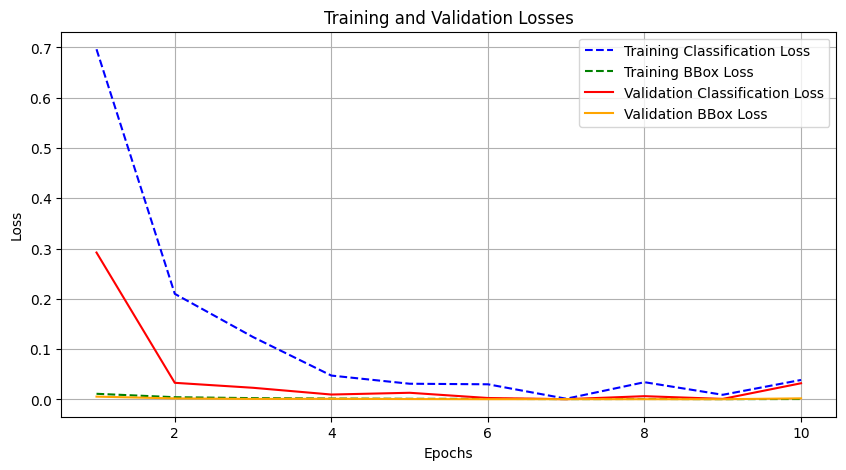

In [ ]:
train_class_losses, train_bbox_losses, val_class_losses, val_bbox_losses = lib_8.train_model(
    model, train_loader, val_loader, optimizer, class_loss_fn, bbox_loss_fn, device, num_epochs=10, patience=5)

# Save the final model after training, regardless of early stopping
torch.save(model.state_dict(), 'final_model.pth')
print('Final model saved after training completes.')

lib_8.plot_losses(train_class_losses, train_bbox_losses, val_class_losses, val_bbox_losses)

Инициализируем и загружаем лучших веса улучшенной кастомной модели.

In [ ]:
# Initialize the model with the same architecture as used during training
model = lib_8.CustomModel(num_classes=3).to(device)

# Load the saved weights from the training
model.load_state_dict(torch.load('best_model.pth'))  # or 'best_model.pth'

# Set the model to evaluation mode
model.eval()

CustomModel(
  (backbone): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (8): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): ReLU()
    (11): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (12): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=Tru

Вычисляем и выводим метрики качества улучшенной кастомной модели - Precision, Recall, матрица ошибок, mAP (Mean Average Precision).

In [ ]:
# Load the model, data, and compute metrics
precision, recall, conf_matrix, mAP_result, mean_iou = lib_8.evaluate_model_with_metrics(model, test_loader, device)

# Print the evaluation results
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"Confusion Matrix:\n{conf_matrix}")
print(f"mAP: {mAP_result['map']:.4f}")

Precision: 1.0000
Recall: 1.0000
Confusion Matrix:
[[69  0  0]
 [ 0 65  0]
 [ 0  0 66]]
mAP: 0.4850


Визуализируем предсказания улучшенной кастомной модели на тестовых данных с отображением:
* Исходного изображения
* Ground truth и предсказанных bbox
* Значения IoU для каждого примера

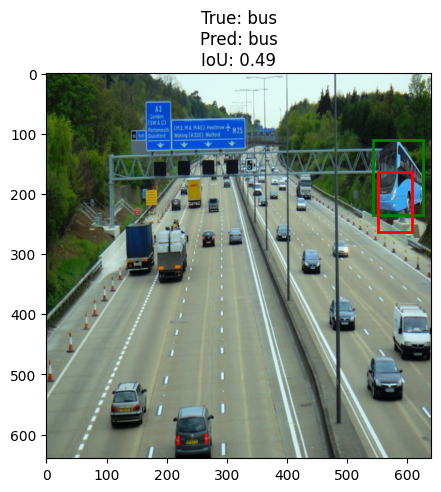

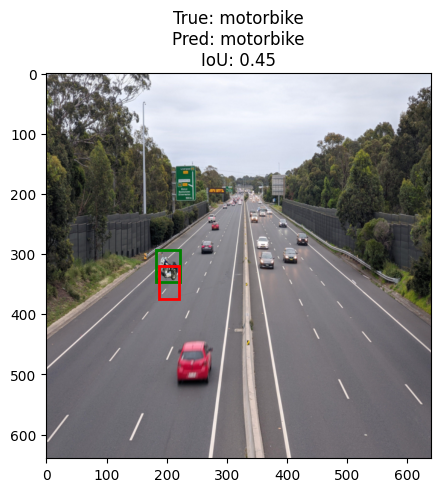

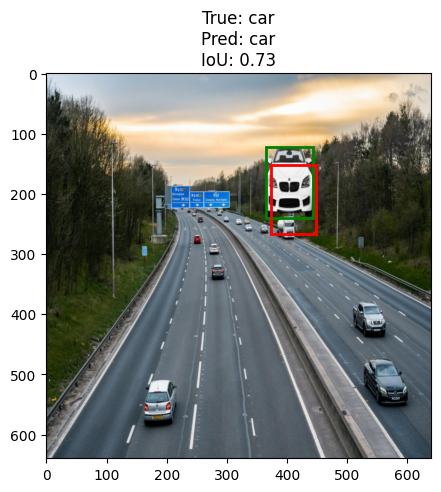

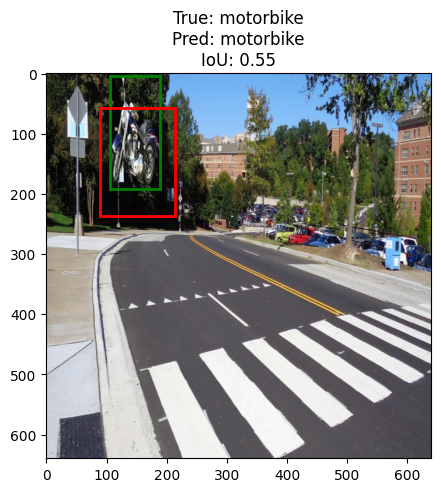

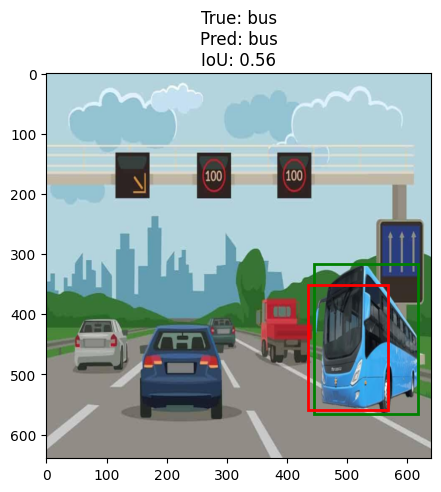

...

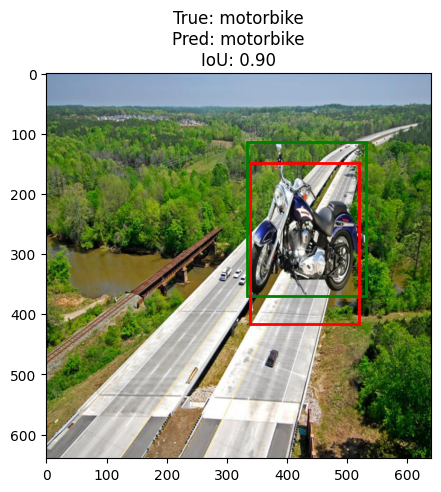

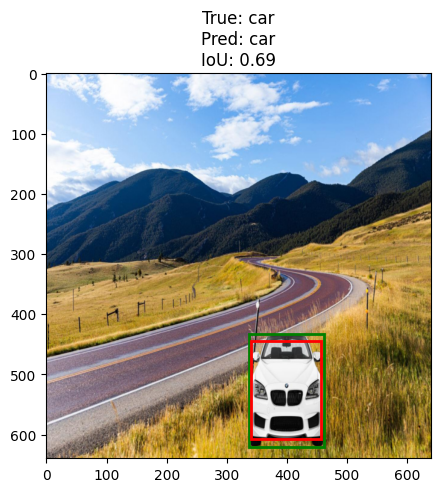

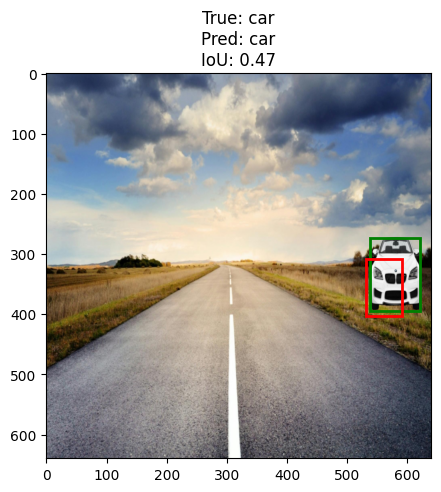

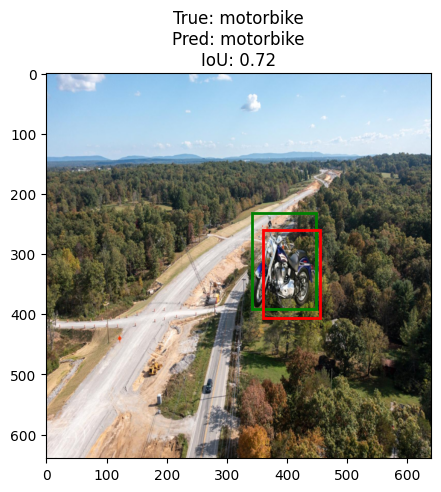

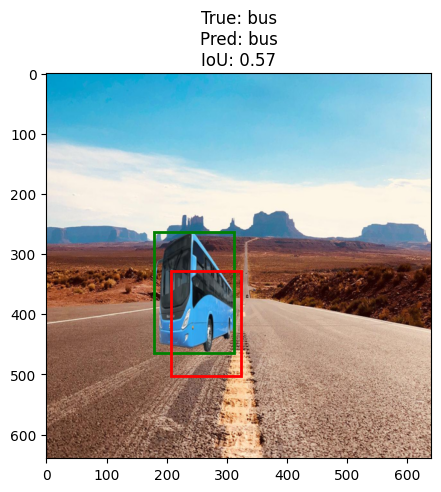

In [ ]:
lib_8.show_predictions_one_by_one(model, test_dataset, classes, device, num_images=30)

**Анализ:**
Результаты обучения модели выглядят очень хорошо с точки зрения классификации, mAP (mean Average Precision) значительно улучшился по сравнению с первой реализацией модели.
1. Динамика обучения (Loss)
  * Train Class Loss снизился с 0.6966 до 0.0093–0.0388 — это говорит о быстром и устойчивом обучении классификатора.
  * Train BBox Loss также уменьшился: с 0.0113 до ~0.0007–0.0012 — отличное качество регрессии координат.
  * Аналогично, Val Loss (классификация + BBox) падает стабильно до эпохи 9, где достигается минимум: 0.0161.
  * Вывод: модель не переобучается, хорошо обобщается. Очень адекватная динамика обучения.
2. Early stopping и поведение в последних эпохах
  * С 7-й эпохи активируется early stopping: потери почти достигли "дна", модель входит в стадию плато с незначительными колебаниями.
  * Тем не менее, в 9-й эпохе ещё происходит улучшение, что и зафиксировано сохранением модели.
3. Метрики на тесте
  * Precision: 1.0000. Recall: 1.0000. Идеальная Confusion Matrix
  * Вывод: модель абсолютно точно классифицирует объекты (мотоцикл, автобус, машина) без ошибок. Это суперрезультат, особенно на валидации или тесте.
4. mAP: 0.4850
  * При идеальной классификации и координатах, mAP должен быть ближе к 1.0.
  * Значение 0.4850 указывает, что:
    * Intersection over Union (IoU), используемый для оценки локализации, не достигает высоких значений, несмотря на низкий BBox Loss.
    * Возможны недостаточно точные bounding boxes или низкий confidence score при выводе (если mAP считает с порогом, например 0.5 IoU + confidence > 0.5).
    * Ещё одна причина может быть в сильно несбалансированной выборке или в способе подсчёта mAP (например, VOC против COCO).
**Вывод:**
* Классификация	- идеальная (Precision/Recall = 1.0)
* Локализация	- точные боксы по loss, но mAP занижен
* Обучение - устойчивая сходимость, раннее сохранение оптимальной модели
* Общая модель - сильная, особенно для задач классификации и первичной локализации


## **Выводы**

Проанализируем результаты, полученные всеми алгоритмами. Для этого представим все данные в виде таблицы для удобства анализа.

In [5]:
data = {
    'Модель': ['YOLOv11', 'YOLOv8', 'Custom', 'Improved Custom'],
    'Precision': [1.0, 1.0, 0.9794, 1.0],
    'Recall': [1.0, 1.0, 0.9831, 1.0],
    'Confusion Matrix': ['ideal', 'ideal', 'small errors', 'ideal'],
    'mAP': [0.995, 0.995, 0, 0.485]
}

table = pd.DataFrame(data)
table

,Модель,Precision,Recall,Confusion Matrix,mAP
0,YOLOv11,1.0000,1.0000,ideal,0.995
1,YOLOv8,1.0000,1.0000,ideal,0.995
2,Custom,0.9794,0.9831,small errors,0.000
3,Improved Custom,1.0000,1.0000,ideal,0.485


На основе полученных результатов лабораторной работы можно сделать следующие выводы относительно производительности различных моделей для задачи обнаружения объектов:

1. **YOLOv11 и YOLOv8:**
  * Оба варианта YOLOv11 и YOLOv8 продемонстрировали идеальные результаты с Precision и Recall, равными 1.0000, что свидетельствует о том, что модели правильно классифицировали все объекты без ложных срабатываний.
  * Матрица ошибок для обеих моделей является идеальной, что подтверждает отсутствие ошибок классификации.
  * mAP этих моделей составил 0.995, что подтверждает высокую производительность как в задаче классификации, так и в задаче локализации объектов.
2. **Custom модель:**
  * Custom модель показала Precision = 0.9794 и Recall = 0.9831, что указывает на то, что модель достаточно хорошо справляется с задачей классификации и локализации объектов, но при этом имеет некоторые ошибки, что привело к небольшому снижению показателей по сравнению с YOLO моделями.
  * Матрица ошибок свидетельствует о наличии небольших ошибок, особенно в части локализации объектов.
  * mAP для этой модели составил 0.000, что указывает на проблемы с локализацией объектов, несмотря на хорошие результаты в классификации.
3. **Improved Custom модель:**
  * Improved Custom модель была улучшена для повышения результатов обучения, и это отразилось на Precision и Recall, которые теперь составляют 1.0000, что говорит о идеальных значениях в классификации объектов.
  * Матрица ошибок также является идеальной, что подтверждает, что модель теперь классифицирует все объекты правильно, без ошибок.
  * Важным улучшением является то, что mAP для улучшенной модели составил 0.485, что значительно выше, чем у Custom модели. Это говорит о том, что улучшения в обучении также положительно сказались на локализации объектов, несмотря на оставшиеся сложности.

**Резюме:**

YOLOv11 и YOLOv8 продемонстрировали наилучшие результаты во всех аспектах: точность классификации и локализации практически идеальна, а mAP близка к максимальному значению.

Custom модель показала хорошие результаты в классификации, но проблемы с локализацией привели к mAP = 0.000, что является значительным ограничением.

Improved Custom модель продемонстрировала значительное улучшение: Precision и Recall = 1.0000, а также увеличение mAP до 0.485, что указывает на улучшение локализации объектов по сравнению с Custom моделью.